In [1]:
# Use a different mount point to avoid conflicts.
from google.colab import drive
drive.mount('/content/mydrive')

Mounted at /content/mydrive


In [2]:
!pip install torch torchvision

In [3]:
import torch
x = torch.rand(5, 3)
print(x)

tensor([[0.3067, 0.9149, 0.2705],
        [0.0463, 0.7800, 0.3410],
        [0.5244, 0.6449, 0.7368],
        [0.0147, 0.2868, 0.8985],
        [0.0526, 0.5180, 0.7479]])


In [4]:
import torch
if torch.cuda.is_available():
    print(f"GPU: {torch.cuda.get_device_name(0)} is available.")
else:
    print("No GPU available. Training will run on CPU.")

GPU: NVIDIA A100-SXM4-40GB is available.


In [5]:
import torch
# Create a tensor on the CPU
tensor = torch.randn((3, 3))
#Move the tensor to the GPU
tensor = tensor.to('cuda')

In [6]:
import torch
import torch.nn as nn

model = nn.Conv2d(3, 64, 3, 1, 1) # Create a model

model = nn.DataParallel(model) # Wrap the model with DataParallel

model = model.to('cuda') # Move the model to the GPU
# Perform forward pass on the model
input_data = torch.randn(20, 3, 32, 32).to('cuda')
output = model(input_data)

In [7]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

In [8]:
!pip install tensorflow

In [9]:
device

device(type='cuda')

In [10]:
import tensorflow as tf

# Check if GPU is available.
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))
print("Available GPUs:", tf.config.list_physical_devices('GPU'))

# Show details about the detected GPU.
!nvidia-smi

Num GPUs Available:  1
Available GPUs: [PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]
Sat Oct 12 19:56:44 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off | 00000000:00:04.0 Off |                    0 |
| N/A   31C    P0              50W / 400W |    525MiB / 40960MiB |      0%      Default |
|                                         |         

In [11]:
!nvcc --version

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2023 NVIDIA Corporation
Built on Tue_Aug_15_22:02:13_PDT_2023
Cuda compilation tools, release 12.2, V12.2.140
Build cuda_12.2.r12.2/compiler.33191640_0


In [12]:
!gcc --version

gcc (Ubuntu 11.4.0-1ubuntu1~22.04) 11.4.0
Copyright (C) 2021 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



Load the data using pytorch

In [13]:
!pip install torch_snippets torch_summary --quiet
import itertools
from PIL import Image
from torch_snippets import *
from torchvision import transforms
from torchvision.utils import make_grid
from torchsummary import summary

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.6/78.6 kB 3.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 103.0/103.0 kB 9.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.7/82.7 kB 7.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 119.4/119.4 kB 11.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.5/62.5 kB 5.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 218.7/218.7 kB 19.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 162.6/162.6 kB 15.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.0/99.0 kB 9.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.0/6.0 MB 81.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 469.0/469.0 kB 38.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 89.7 MB/s eta 0:00:00


In [14]:
img = Image.open('/content/mydrive/MyDrive/HW_06 Dataset/testA/00010.jpg')
img.size

(256, 256)

In [15]:
IMAGE_SIZE = 256
device = 'cuda' if torch.cuda.is_available() else 'cpu'
transform = transforms.Compose([
    transforms.Resize(int(IMAGE_SIZE*1.33)),
    transforms.RandomCrop((IMAGE_SIZE,IMAGE_SIZE)),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

In [79]:
class Photo2MonetDataset(Dataset):
    def __init__(self, photos, monets):
        ### Getting the list of images
        self.photos = glob(photos)
        self.monets = glob(monets)

    def __getitem__(self, ix):
        photo = self.photos[ix % len(self.photos)]
        ### Choosing a random Monet image to pair with the chosen photo image
        monet = self.choose(self.monets)
        photo = Image.open(photo).convert('RGB')
        monet = Image.open(monet).convert('RGB')
        return photo, monet

    def __len__(self):
        return max(len(self.photos), len(self.monets))

    def choose(self, items):return items[torch.randint(0, len(items), (1,)).item()]

    def collate_fn(self, batch):  # Batch function
        ### The zip function breaks the tuples into two lists
        srcs, trgs = list(zip(*batch))

        srcs = torch.cat([transform(img)[None] for img in srcs], 0).to(device).float()
        trgs = torch.cat([transform(img)[None] for img in trgs], 0).to(device).float()
        return srcs.to(device), trgs.to(device)

In [80]:
# Define the paths to the train and test datasets
train_monet_path = '/content/mydrive/MyDrive/HW_06 Dataset/trainA/*.jpg'  # Path to Monet images for training
train_photo_path = '/content/mydrive/MyDrive/HW_06 Dataset/trainB/*.jpg'  # Path to Photo images for training

test_monet_path = '/content/mydrive/MyDrive/HW_06 Dataset/testA/*.jpg'    # Path to Monet images for testing
test_photo_path = '/content/mydrive/MyDrive/HW_06 Dataset/testB/*.jpg'    # Path to Photo images for testing

# Initialize the dataset class with the correct paths
trn_ds = Photo2MonetDataset(photos=train_photo_path, monets=train_monet_path)
val_ds = Photo2MonetDataset(photos=test_photo_path, monets=test_monet_path)

# Initialize the DataLoader
trn_dl = DataLoader(trn_ds, batch_size=1, shuffle=True, collate_fn=trn_ds.collate_fn)
val_dl = DataLoader(val_ds, batch_size=5, shuffle=True, collate_fn=val_ds.collate_fn)

In [81]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
        if hasattr(m, "bias") and m.bias is not None:
            torch.nn.init.constant_(m.bias.data, 0.0)
    elif classname.find("BatchNorm2d") != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)

In [82]:
class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()

        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
            nn.ReLU(inplace=True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
        )

    def forward(self, x):
        return x + self.block(x)

In [83]:
class GeneratorResNet(nn.Module):
    def __init__(self, num_residual_blocks=9):
        super(GeneratorResNet, self).__init__()
        out_features = 64
        channels = 3
        model = [
            nn.ReflectionPad2d(3),
            nn.Conv2d(channels, out_features, 7),
            nn.InstanceNorm2d(out_features),
            nn.ReLU(inplace=True),
        ]
        in_features = out_features
        # Downsampling
        for _ in range(2):
            out_features *= 2
            model += [
                nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True),
            ]
            in_features = out_features

        # Residual blocks
        for _ in range(num_residual_blocks):
            model += [ResidualBlock(out_features)]

        # Upsampling
        for _ in range(2):
            out_features //= 2
            model += [
                nn.Upsample(scale_factor=2),
                nn.Conv2d(in_features, out_features, 3, stride=1, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True),
            ]
            in_features = out_features

        # Output layer
        model += [nn.ReflectionPad2d(channels), nn.Conv2d(out_features, channels, 7), nn.Tanh()]
        self.model = nn.Sequential(*model)
        self.apply(weights_init_normal)
    def forward(self, x):
        return self.model(x)

In [84]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        channels, height, width = 3, IMAGE_SIZE, IMAGE_SIZE

        def discriminator_block(in_filters, out_filters, normalize=True):
            """Returns downsampling layers of each discriminator block"""
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalize:
                layers.append(nn.InstanceNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *discriminator_block(channels, 64, normalize=False),
            *discriminator_block(64, 128),
            *discriminator_block(128, 256),
            *discriminator_block(256, 512),
            nn.ZeroPad2d((1, 0, 1, 0)),
            nn.Conv2d(512, 1, 4, padding=1)
        )
        self.apply(weights_init_normal)

    def forward(self, img):
        return self.model(img)

In [85]:
@torch.no_grad()
def generate_sample():
    data = next(iter(val_dl))
    G_AB.eval()
    G_BA.eval()

    real_A, real_B = data
    fake_B = G_AB(real_A)
    fake_A = G_BA(real_B)
    # Arange images along x-axis
    real_A = make_grid(real_A, nrow=5, normalize=True)
    real_B = make_grid(real_B, nrow=5, normalize=True)
    fake_A = make_grid(fake_A, nrow=5, normalize=True)
    fake_B = make_grid(fake_B, nrow=5, normalize=True)
    # Arange images along y-axis
    image_grid = torch.cat((real_A, fake_B, real_B, fake_A), 1)
    show(image_grid.detach().cpu().permute(1,2,0).numpy(), sz=12)

In [86]:
def generator_train_step(Gs, optimizer, real_A, real_B):
    G_AB, G_BA = Gs
    optimizer.zero_grad()
    loss_id_A = criterion_identity(G_BA(real_A), real_A)
    loss_id_B = criterion_identity(G_AB(real_B), real_B)

    loss_identity = (loss_id_A + loss_id_B) / 2
    fake_B = G_AB(real_A)
    loss_GAN_AB = criterion_GAN(D_B(fake_B), torch.Tensor(np.ones((len(real_A), 1, 16, 16))).to(device))
    fake_A = G_BA(real_B)
    loss_GAN_BA = criterion_GAN(D_A(fake_A), torch.Tensor(np.ones((len(real_A), 1, 16, 16))).to(device))

    loss_GAN = (loss_GAN_AB + loss_GAN_BA) / 2
    recov_A = G_BA(fake_B)
    loss_cycle_A = criterion_cycle(recov_A, real_A)
    recov_B = G_AB(fake_A)
    loss_cycle_B = criterion_cycle(recov_B, real_B)

    loss_cycle = (loss_cycle_A + loss_cycle_B) / 2
    loss_G = loss_GAN + lambda_cyc * loss_cycle + lambda_id * loss_identity
    loss_G.backward()
    optimizer.step()
    return loss_G, loss_identity, loss_GAN, loss_cycle, loss_G, fake_A, fake_B


In [87]:
def discriminator_train_step(D, real_data, fake_data, optimizer):
    optimizer.zero_grad()
    loss_real = criterion_GAN(D(real_data), torch.Tensor(np.ones((len(real_data), 1, 16, 16))).to(device))
    loss_fake = criterion_GAN(D(fake_data.detach()), torch.Tensor(np.zeros((len(real_data), 1, 16, 16))).to(device))
    loss_D = (loss_real + loss_fake) / 2
    loss_D.backward()
    optimizer.step()
    return loss_D

In [88]:
G_AB = GeneratorResNet().to(device)
G_BA = GeneratorResNet().to(device)
D_A = Discriminator().to(device)
D_B = Discriminator().to(device)

criterion_GAN = torch.nn.MSELoss()
criterion_cycle = torch.nn.L1Loss()
criterion_identity = torch.nn.L1Loss()

optimizer_G = torch.optim.Adam(
    itertools.chain(G_AB.parameters(), G_BA.parameters()), lr=0.0002, betas=(0.5, 0.999)
)
optimizer_D_A = torch.optim.Adam(D_A.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D_B = torch.optim.Adam(D_B.parameters(), lr=0.0002, betas=(0.5, 0.999))

lambda_cyc, lambda_id = 10.0, 5.0

In [89]:
class Report:
    def __init__(self, n_epochs):
        self.n_epochs = n_epochs
        self.history = []

    def record(self, epoch, **metrics):
        self.history.append(metrics)
        # Print out the progress for the current epoch
        metrics_str = ' '.join([f'{k}: {v:.3f}' for k, v in metrics.items()])
        print(f'EPOCH: {int(epoch)} {metrics_str}', end='\r')

    def report_avgs(self, epoch):
        # Compute average of all recorded metrics for the epoch
        avg_metrics = {}
        for entry in self.history:
            for k, v in entry.items():
                avg_metrics[k] = avg_metrics.get(k, 0) + v

        for k in avg_metrics:
            avg_metrics[k] /= len(self.history)

        # Print the average metrics for the epoch
        metrics_str = ' '.join([f'{k}: {v:.3f}' for k, v in avg_metrics.items()])
        print(f'\nAverage metrics for EPOCH {epoch}: {metrics_str}')
        self.history.clear()  # Clear history after reporting

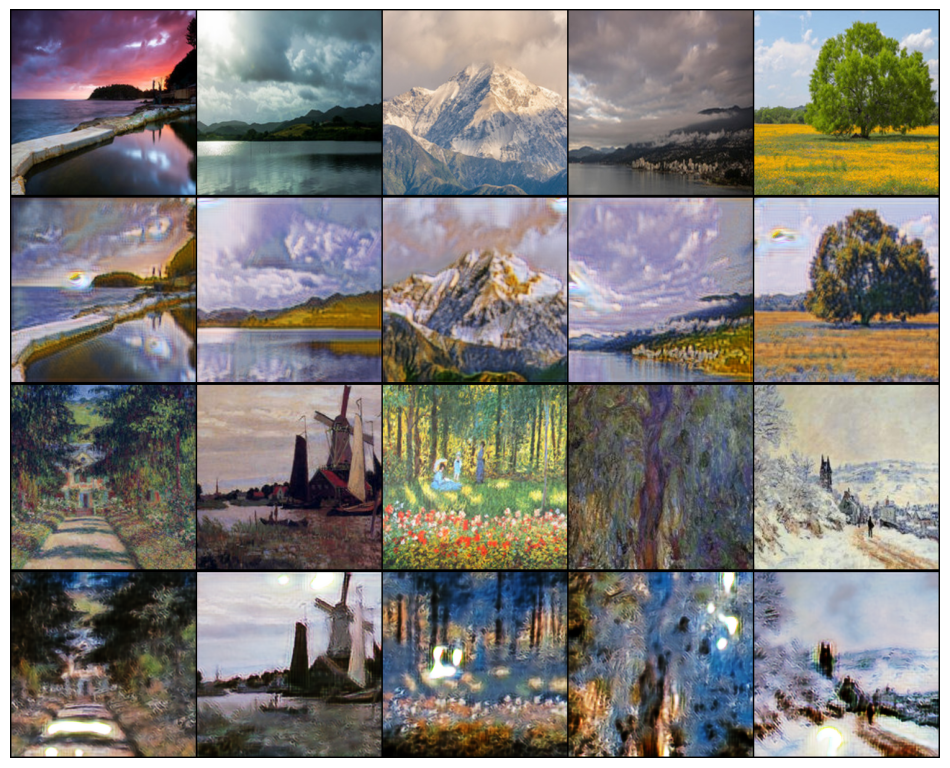

In [90]:
n_epochs = 1
log = Report(n_epochs)

for epoch in range(n_epochs):
    N = len(trn_dl)

    for bx, batch in enumerate(trn_dl):
        real_A, real_B = batch

        # Generator training step
        loss_G, loss_identity, loss_GAN, loss_cycle, loss_G, fake_A, fake_B = generator_train_step((G_AB, G_BA), optimizer_G, real_A, real_B)

        # Discriminator training steps
        loss_D_A = discriminator_train_step(D_A, real_A, fake_A, optimizer_D_A)
        loss_D_B = discriminator_train_step(D_B, real_B, fake_B, optimizer_D_B)
        loss_D = (loss_D_A + loss_D_B) / 2

        # Remove the 'end' argument here
        log.record(epoch+(1+bx)/N, loss_D=loss_D.item(), loss_G=loss_G.item(),
                   loss_GAN=loss_GAN.item(), loss_cycle=loss_cycle.item(),
                   loss_identity=loss_identity.item())

    # Generate sample images after each epoch
    generate_sample()

    # Report average metrics for the epoch
    log.report_avgs(epoch + 1)

In [91]:
import os

# Function to save the checkpoint
def save_checkpoint(epoch, G_AB, G_BA, D_A, D_B, optimizer_G, optimizer_D_A, optimizer_D_B, checkpoint_dir='checkpoints'):
    if not os.path.exists(checkpoint_dir):
        os.makedirs(checkpoint_dir)

    checkpoint = {
        'epoch': epoch,
        'G_AB_state_dict': G_AB.state_dict(),
        'G_BA_state_dict': G_BA.state_dict(),
        'D_A_state_dict': D_A.state_dict(),
        'D_B_state_dict': D_B.state_dict(),
        'optimizer_G_state_dict': optimizer_G.state_dict(),
        'optimizer_D_A_state_dict': optimizer_D_A.state_dict(),
        'optimizer_D_B_state_dict': optimizer_D_B.state_dict(),
    }

    torch.save(checkpoint, os.path.join(checkpoint_dir, f'checkpoint_epoch_{epoch}.pth'))

# Function to load the checkpoint
def load_checkpoint(filepath, G_AB, G_BA, D_A, D_B, optimizer_G, optimizer_D_A, optimizer_D_B):
    checkpoint = torch.load(filepath)
    G_AB.load_state_dict(checkpoint['G_AB_state_dict'])
    G_BA.load_state_dict(checkpoint['G_BA_state_dict'])
    D_A.load_state_dict(checkpoint['D_A_state_dict'])
    D_B.load_state_dict(checkpoint['D_B_state_dict'])
    optimizer_G.load_state_dict(checkpoint['optimizer_G_state_dict'])
    optimizer_D_A.load_state_dict(checkpoint['optimizer_D_A_state_dict'])
    optimizer_D_B.load_state_dict(checkpoint['optimizer_D_B_state_dict'])
    return checkpoint['epoch']

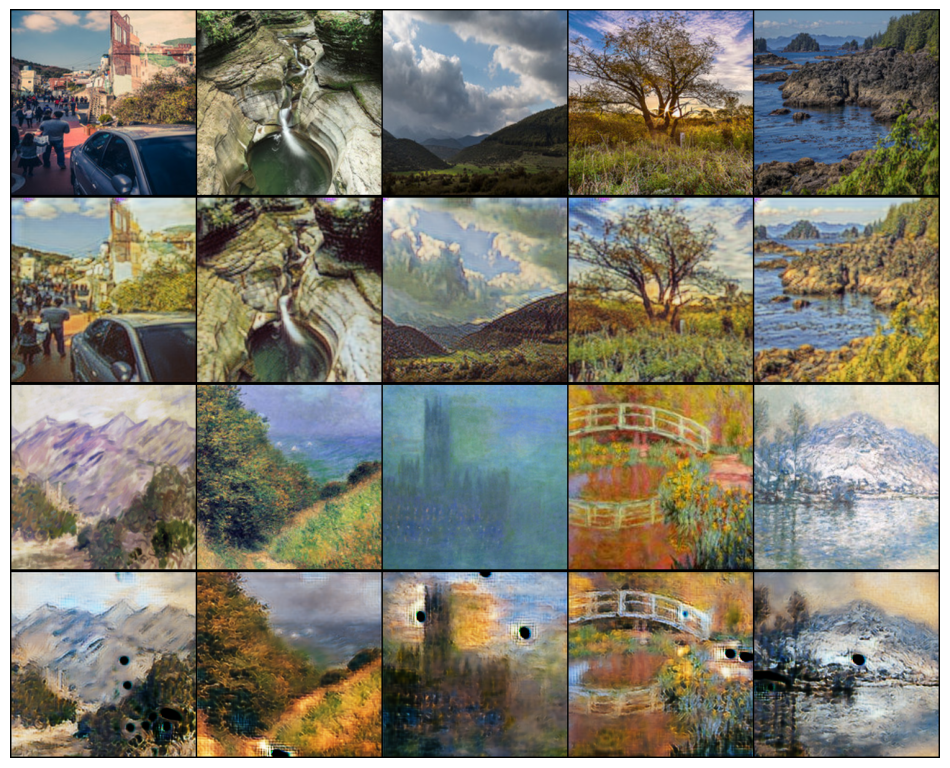


Average metrics for EPOCH 1: loss_D: 0.210 loss_G: 3.385 loss_GAN: 0.486 loss_cycle: 0.199 loss_identity: 0.182


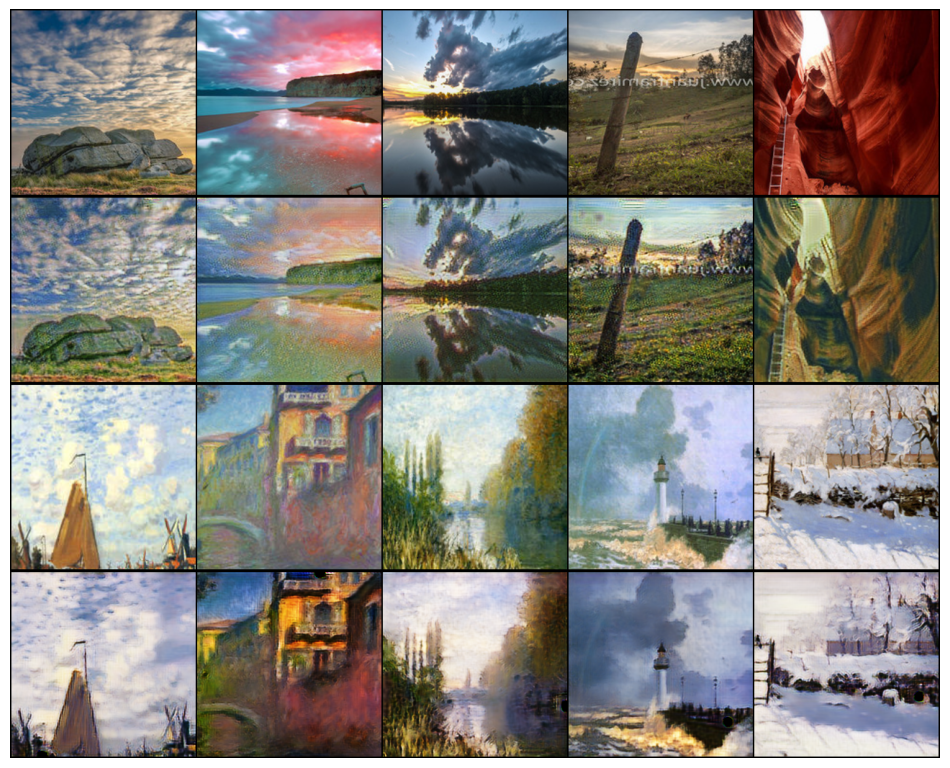


Average metrics for EPOCH 2: loss_D: 0.197 loss_G: 3.107 loss_GAN: 0.504 loss_cycle: 0.178 loss_identity: 0.164


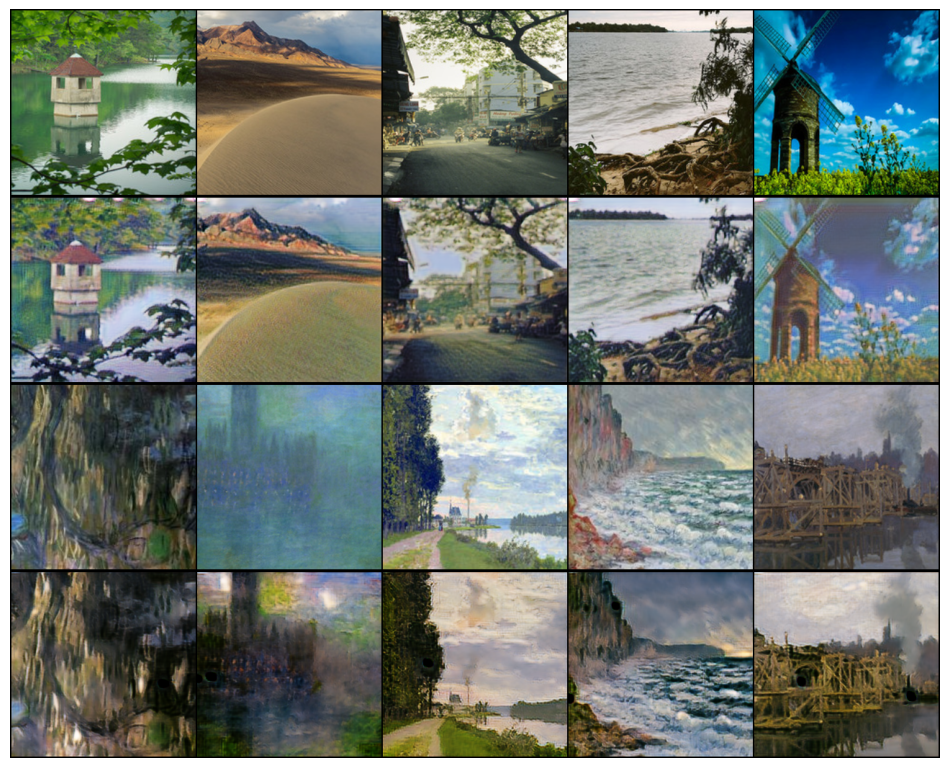


Average metrics for EPOCH 3: loss_D: 0.186 loss_G: 2.994 loss_GAN: 0.527 loss_cycle: 0.168 loss_identity: 0.157


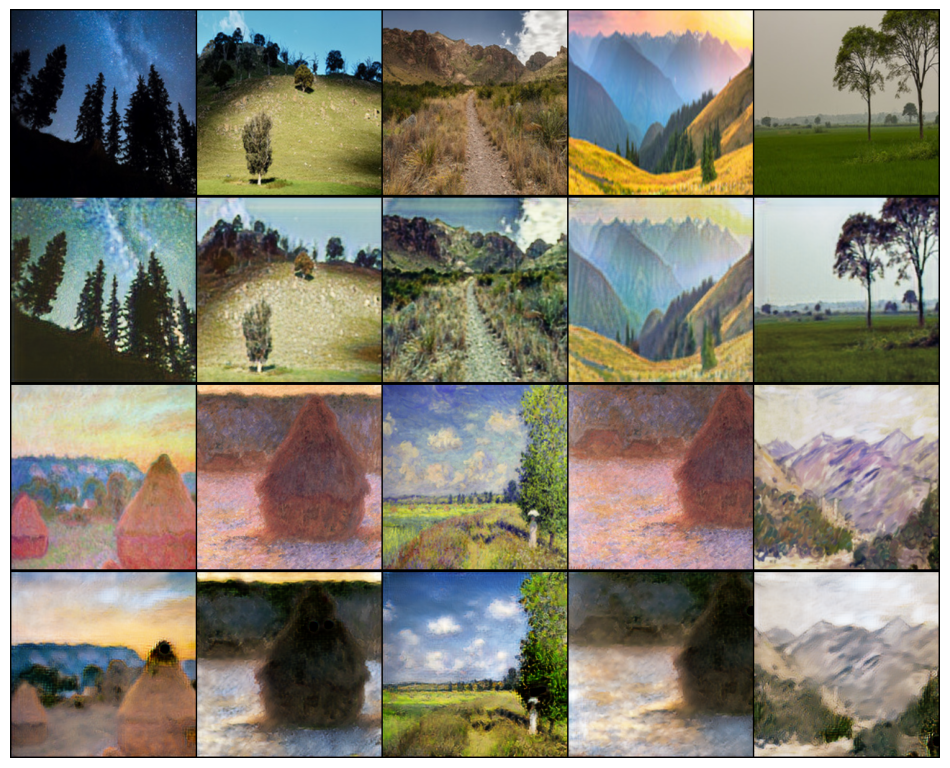


Average metrics for EPOCH 4: loss_D: 0.178 loss_G: 2.935 loss_GAN: 0.545 loss_cycle: 0.163 loss_identity: 0.152


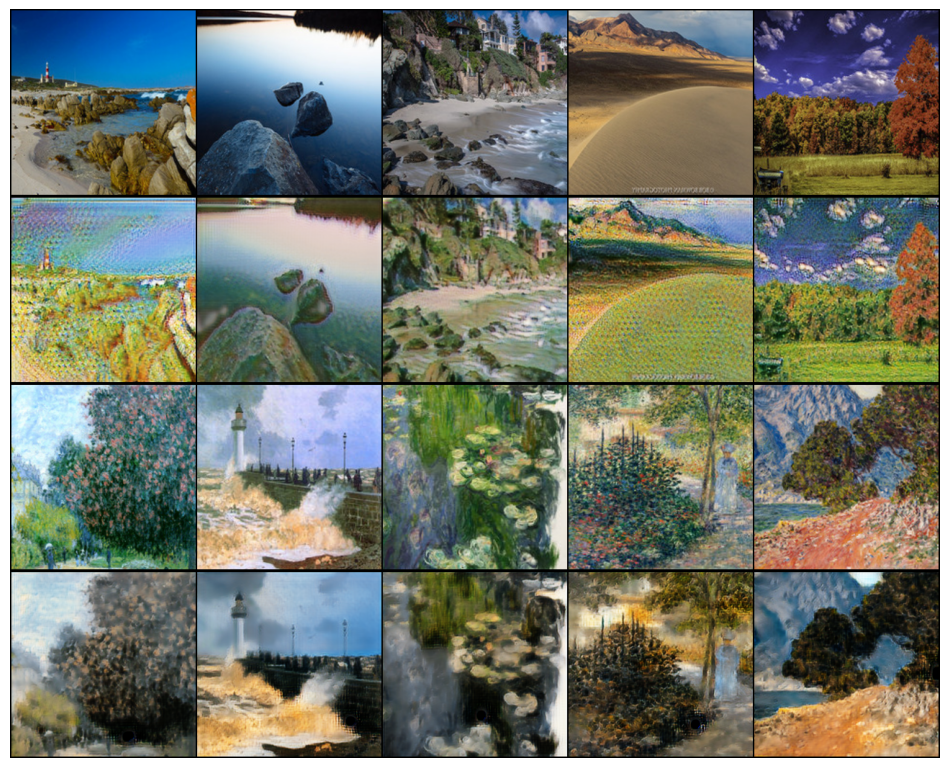


Average metrics for EPOCH 5: loss_D: 0.167 loss_G: 2.909 loss_GAN: 0.571 loss_cycle: 0.159 loss_identity: 0.149


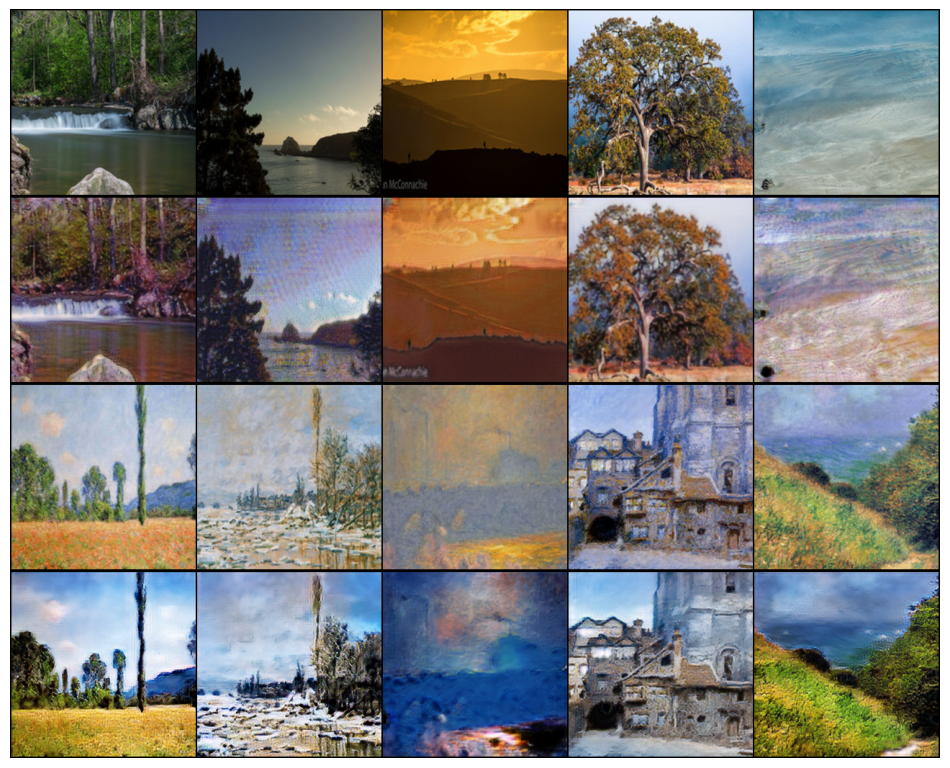


Average metrics for EPOCH 6: loss_D: 0.168 loss_G: 2.852 loss_GAN: 0.567 loss_cycle: 0.155 loss_identity: 0.146


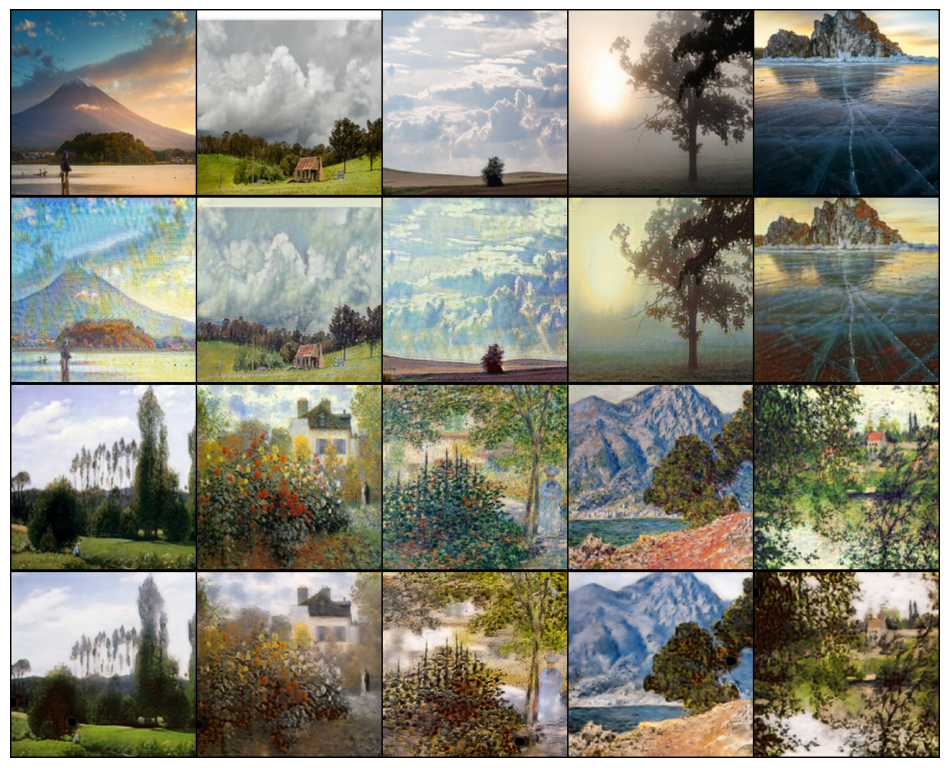


Average metrics for EPOCH 7: loss_D: 0.164 loss_G: 2.807 loss_GAN: 0.572 loss_cycle: 0.152 loss_identity: 0.144


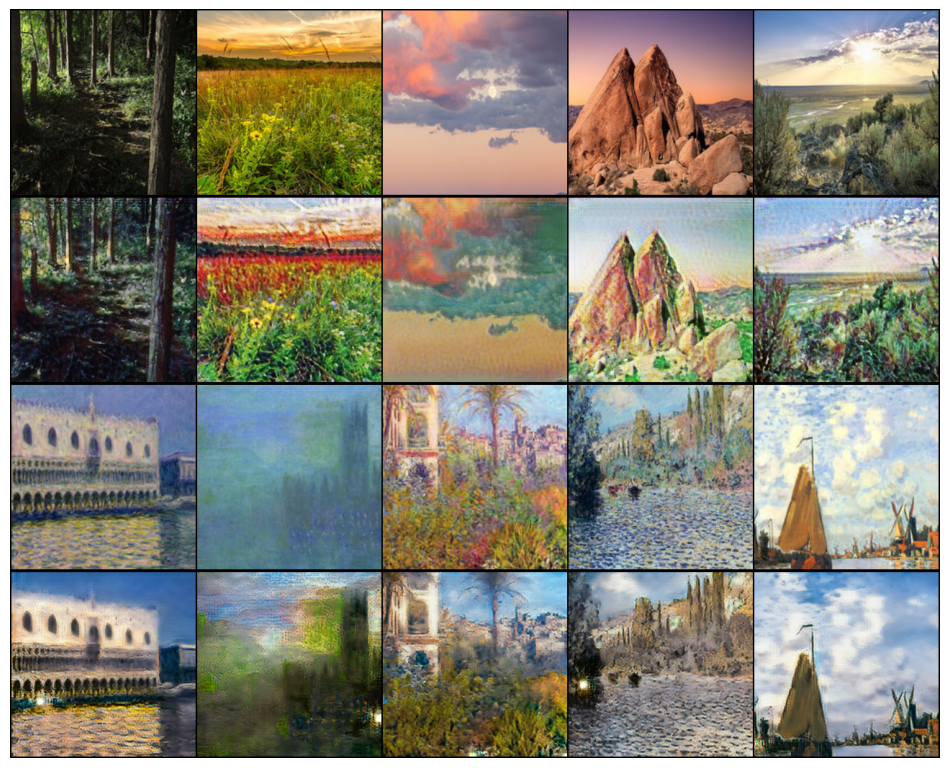


Average metrics for EPOCH 8: loss_D: 0.161 loss_G: 2.791 loss_GAN: 0.581 loss_cycle: 0.150 loss_identity: 0.141


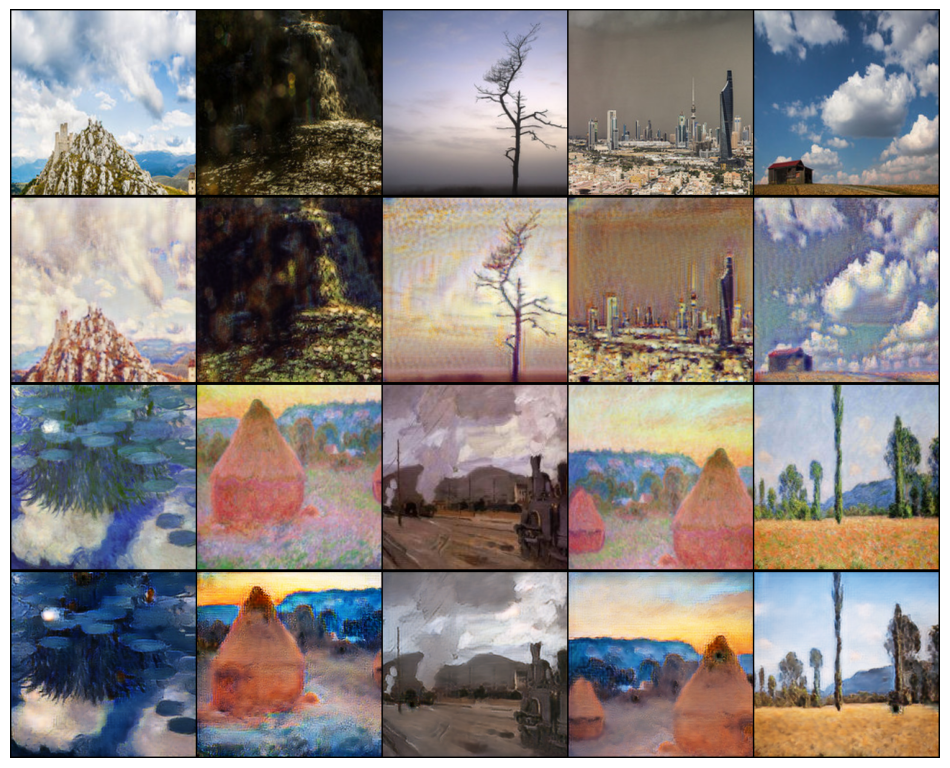


Average metrics for EPOCH 9: loss_D: 0.180 loss_G: 2.658 loss_GAN: 0.524 loss_cycle: 0.145 loss_identity: 0.136


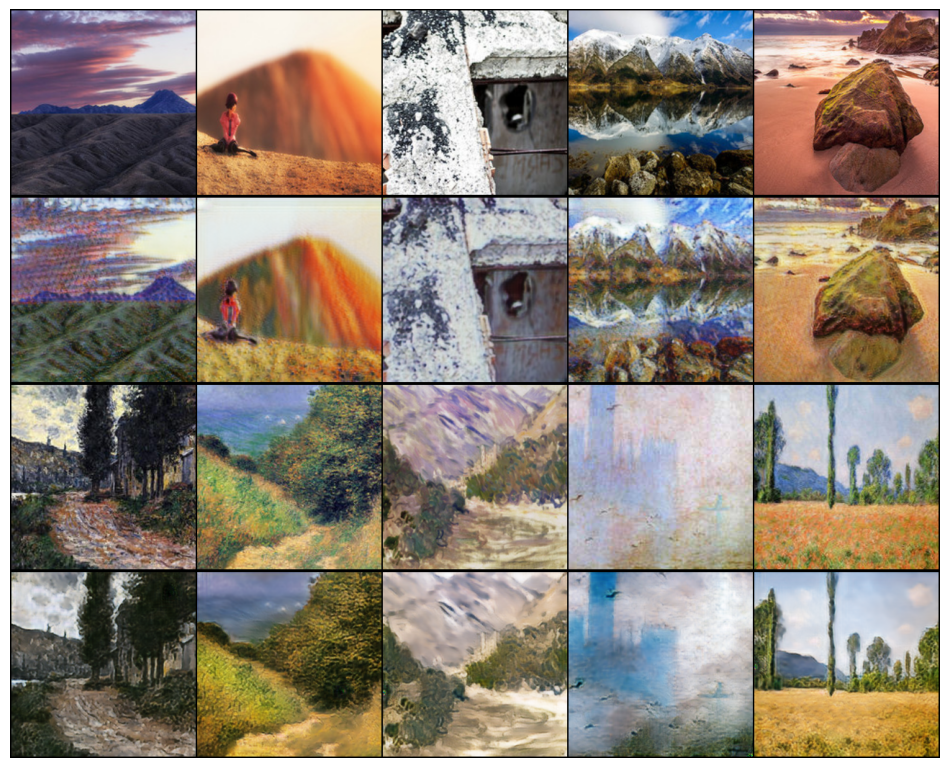


Average metrics for EPOCH 10: loss_D: 0.177 loss_G: 2.622 loss_GAN: 0.527 loss_cycle: 0.143 loss_identity: 0.134


KeyboardInterrupt: 

In [92]:
n_epochs = 20
checkpoint_dir = 'checkpoints'
log = Report(n_epochs)

for epoch in range(n_epochs):
    N = len(trn_dl)

    for bx, batch in enumerate(trn_dl):
        real_A, real_B = batch

        # Generator training step
        loss_G, loss_identity, loss_GAN, loss_cycle, loss_G, fake_A, fake_B = generator_train_step((G_AB, G_BA), optimizer_G, real_A, real_B)

        # Discriminator training steps
        loss_D_A = discriminator_train_step(D_A, real_A, fake_A, optimizer_D_A)
        loss_D_B = discriminator_train_step(D_B, real_B, fake_B, optimizer_D_B)
        loss_D = (loss_D_A + loss_D_B) / 2

        # Log the losses
        log.record(epoch+(1+bx)/N, loss_D=loss_D.item(), loss_G=loss_G.item(),
                   loss_GAN=loss_GAN.item(), loss_cycle=loss_cycle.item(),
                   loss_identity=loss_identity.item())

    # Generate sample images after each epoch
    generate_sample()

    # Save the checkpoint
    save_checkpoint(epoch, G_AB, G_BA, D_A, D_B, optimizer_G, optimizer_D_A, optimizer_D_B, checkpoint_dir)

    # Report average metrics for the epoch
    log.report_avgs(epoch + 1)

Inturrepted at epoch EPOCH 9 since its taking so much time , for each EPOCH , the model is saved , so going to use the model at epoch 9 

<ipython-input-91-6d5fad686493>:23: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load(filepath)


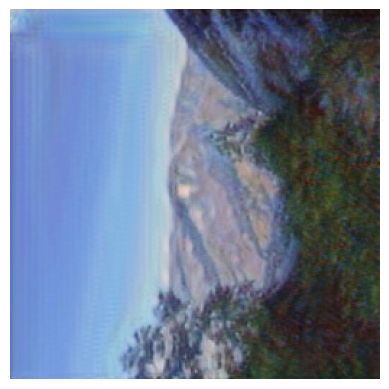

In [95]:
from PIL import Image
import matplotlib.pyplot as plt
import torchvision.transforms as transforms

# Function to convert a custom image into a painting using the loaded G_AB model
def convert_to_painting(image_path, G_AB, transform):
    # Open the custom image
    image = Image.open(image_path).convert('RGB')

    # Apply the same transformations used during training
    image_tensor = transform(image).unsqueeze(0).to(device)

    # Set the model to evaluation mode
    G_AB.eval()

    # Generate the painting using the trained generator
    with torch.no_grad():
        painting_tensor = G_AB(image_tensor)

    # Convert the tensor back to an image format for display
    painting_image = painting_tensor.squeeze(0).cpu().detach().numpy()
    painting_image = (painting_image.transpose(1, 2, 0) + 1) / 2.0  # Rescale to [0, 1]

    # Display the generated painting
    plt.imshow(painting_image)
    plt.axis('off')
    plt.show()

# Path to the custom image (provide the actual path to your image here)
image_path = '/content/mydrive/MyDrive/IMG_0013.jpeg'
# Define the image transformations (same as during training)
transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))  # Normalization used during training
])

# Load the saved model checkpoint
checkpoint_path = 'checkpoints/checkpoint_epoch_9.pth'  # Update this to your saved checkpoint path
load_checkpoint(checkpoint_path, G_AB, G_BA, D_A, D_B, optimizer_G, optimizer_D_A, optimizer_D_B)

# Convert the custom image into a painting
convert_to_painting(image_path, G_AB, transform)

Uploaded an image and this is the converted image

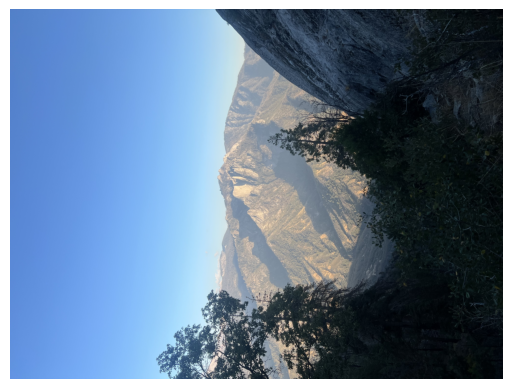

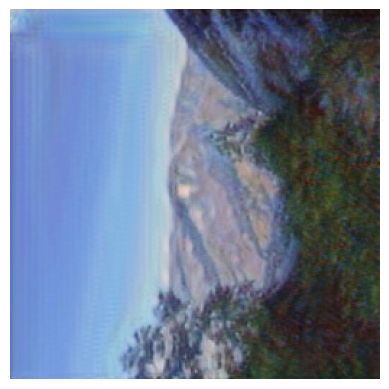

In [97]:
from PIL import Image
import matplotlib.pyplot as plt

# Open and display the image
image_path = '/content/mydrive/MyDrive/IMG_0013.jpeg'
image = Image.open(image_path)

# Display the image using matplotlib
plt.imshow(image)
plt.axis('off')  # Hide the axes for better visualization
plt.show()
convert_to_painting(image_path, G_AB, transform)